# Setup

In [ ]:
#!pip install plotly==4.0.0

In [ ]:
# google import
# from google.colab import drive
# drive.mount('/content/drive')

In [1]:
#dependencies
import pandas as pd
from matplotlib import pyplot as plt
import glob
import os

import seaborn as sns
import plotly.express as px
import gmaps
from config import gkey

from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics

# CSVs

In [2]:
#google files
#csv_all = [i for i in glob.glob('drive/My Drive/Project_1/Resources/*.csv')]

#local csv files
csv_all = [i for i in glob.glob('Resources/*.csv')]
csv_all.sort()

In [3]:
#read csv list
csv_listread = [pd.read_csv(x) for x in csv_all]

/Users/andrew/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3248: DtypeWarning:

Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.

/Users/andrew/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3248: DtypeWarning:

Columns (1,6,442,451,598,607,611,620,624,633,789,802,806,815,971,984,997,1153,1166,1407,1408,1411,1424,1425,1426,1431,1432,1433,1437,1438,1439,1440,1445,1446,1447,1451,1452,1453,1454,1459,1460,1461,1465,1466,1467,1468,1473,1474,1475,1479,1480,1481,1482,1487,1488,1489,1501,1502,1537,1538,1539,1540,1541,1542,1606,1609,1610,1611,1613,1614,1615,1616,1688,1689,1690,1691,1692,1908,1909,1910,1911,1912,1913) have mixed types. Specify dtype option on import or set low_memory=False.

/Users/andrew/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3248: DtypeWarning:

Columns (1,1909,1910,1911,1912,1913) have mixed types. Specify dtype option on import or set low_memory=False.

/Use

In [4]:
#check list
csv_all

['Resources/MERGED1996_97_PP.csv',
 'Resources/MERGED1997_98_PP.csv',
 'Resources/MERGED1998_99_PP.csv',
 'Resources/MERGED1999_00_PP.csv',
 'Resources/MERGED2000_01_PP.csv',
 'Resources/MERGED2001_02_PP.csv',
 'Resources/MERGED2002_03_PP.csv',
 'Resources/MERGED2003_04_PP.csv',
 'Resources/MERGED2004_05_PP.csv',
 'Resources/MERGED2005_06_PP.csv',
 'Resources/MERGED2006_07_PP.csv',
 'Resources/MERGED2007_08_PP.csv',
 'Resources/MERGED2008_09_PP.csv',
 'Resources/MERGED2009_10_PP.csv',
 'Resources/MERGED2010_11_PP.csv',
 'Resources/MERGED2011_12_PP.csv',
 'Resources/MERGED2012_13_PP.csv',
 'Resources/MERGED2013_14_PP.csv',
 'Resources/MERGED2014_15_PP.csv',
 'Resources/MERGED2015_16_PP.csv',
 'Resources/MERGED2016_17_PP.csv',
 'Resources/MERGED2017_18_PP.csv']

In [5]:
#df list
df_list = [pd.DataFrame(f) for f in csv_listread]

In [6]:
#years for keys
yearlist = [x.split('_') for x in csv_all]
yearlist = [x[1] for x in yearlist]
yearlist

['97',
 '98',
 '99',
 '00',
 '01',
 '02',
 '03',
 '04',
 '05',
 '06',
 '07',
 '08',
 '09',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18']

# DataFrame

In [7]:
#concatenate dfs
df = pd.concat(df_list, keys=yearlist)

In [8]:
cols = ['CONTROL',
        'LOCALE',
        'ST_FIPS',
        'REGION',
        
        'AVGFACSAL',
        'ADM_RATE',
        'PREDDEG',
        'HIGHDEG',
        'CDR3',
        'SAT_AVG_ALL',
        'COSTT4_A',
        'C150_4',
        'TUITIONFEE_IN',
        'TUITIONFEE_OUT',
        'TUITFTE',
        'DEBT_MDN_SUPP',
        'MN_EARN_WNE_P6',
        'GRAD_DEBT_MDN10YR',
        'RPY_3YR_RT_SUPP',
           
        'HBCU',
        'PBI',
        'HSI',
        'ANNHI',
        'NANTI',
        'TRIBAL',
        'AANAPII',
        'UGDS',
        'PREDDEG',
           
        'UGDS_WHITENH',
        'UGDS_BLACKNH',
        'UGDS_API',
        'UGDS_AIANOLD',
        'UGDS_HISPOLD',
        
        'UG_NRA',
        'UG_UNKN',
        'UG_WHITENH',
        'UG_BLACKNH',
        'UG_API',
        'UG_AIANOLD',
        'UG_HISPOLD',

        'UGDS_WHITE',
        'UGDS_BLACK',
        'UGDS_HISP',
        'UGDS_ASIAN',
        'UGDS_AIAN',
        'UGDS_NHPI',
        'UGDS_2MOR',
        'UGDS_UNKN',
        'UGDS_NRA']

df_all = df[cols].reset_index(level=[0]).rename(columns={'level_0':'Year'})

df_all.describe()

,CONTROL,LOCALE,ST_FIPS,REGION,AVGFACSAL,ADM_RATE,PREDDEG,HIGHDEG,CDR3,SAT_AVG_ALL,...,UG_HISPOLD,UGDS_WHITE,UGDS_BLACK,UGDS_HISP,UGDS_ASIAN,UGDS_AIAN,UGDS_NHPI,UGDS_2MOR,UGDS_UNKN,UGDS_NRA
count,154205.000000,6614.000000,154227.000000,154227.000000,88298.000000,42565.000000,154228.000000,154228.000000,47815.000000,25780.000000,...,6143.000000,67772.000000,67772.000000,67772.000000,67772.000000,67772.000000,67772.000000,67772.000000,136922.000000,136922.000000
mean,2.120949,19.814484,29.232112,4.552030,5486.713561,0.694145,1.882207,2.208445,0.126643,1061.895423,...,0.106571,0.454202,0.162723,0.138531,0.029390,0.011974,0.003940,0.018089,0.048195,0.015653
std,0.839779,9.537667,16.558247,2.184821,2079.970791,0.215780,0.992137,1.280667,0.089612,127.754534,...,0.203131,0.321912,0.217197,0.215655,0.071292,0.064688,0.031162,0.029834,0.114075,0.048993
min,1.000000,-3.000000,1.000000,0.000000,27.000000,0.000000,0.000000,0.000000,0.000000,514.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,12.000000,13.000000,3.000000,4111.000000,0.555600,1.000000,1.000000,0.055000,980.000000,...,0.006600,0.130100,0.015800,0.011300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.000000,21.000000,29.000000,5.000000,5229.000000,0.718200,2.000000,2.000000,0.118000,1049.000000,...,0.026300,0.496550,0.074100,0.051500,0.009100,0.001800,0.000000,0.008100,0.009500,0.000000
75%,3.000000,22.000000,42.000000,6.000000,6578.000000,0.857100,3.000000,4.000000,0.187000,1125.000000,...,0.098000,0.736700,0.218000,0.161200,0.027500,0.006300,0.001800,0.027000,0.047000,0.012400
max,3.000000,43.000000,78.000000,9.000000,26084.000000,1.000000,4.000000,4.000000,1.000000,1599.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [10]:
df_all['DEBT_MDN_SUPP'].isna().sum()

16742

In [11]:
#combine legacy ethnicity columns
df_all['undergrads_white'] = df_all['UGDS_WHITENH'].fillna(0) + \
    df_all['UG_WHITENH'].fillna(0) + df_all['UGDS_WHITE'].fillna(0)
    
df_all['undergrads_black'] = df_all['UGDS_BLACKNH'].fillna(0) + \
    df_all['UG_BLACKNH'].fillna(0) + df_all['UGDS_BLACK'].fillna(0)
    
df_all['undergrads_hisp'] = df_all['UGDS_HISP'].fillna(0) + \
    df_all['UG_HISPOLD'].fillna(0) + df_all['UGDS_HISPOLD'].fillna(0)

# Minority Serving Schools

In [86]:
#minority df
df_minority = df_all[cols].loc[(df_all['HBCU']==1) | (df_all['PBI']==1) | 
                       (df_all['HSI']==1) |
                       (df_all['TRIBAL']==1) | (df_all['ANNHI']==1) | (df_all['NANTI']==1) |
                       (df_all['AANAPII']==1)].copy()


df_minority = df_minority[['SAT_AVG_ALL', 'CDR3', 'COSTT4_A', 'TUITFTE', 'AVGFACSAL',
                           'HBCU','PBI', 'HSI','ANNHI','NANTI','TRIBAL','AANAPII',
                          'CONTROL','ST_FIPS','REGION']]

#transform column to category
df_minority["HBCU"] = ["HBCU" if ele  == 1 else '' for ele in df_minority["HBCU"]]
df_minority["PBI"] = ["PBI" if ele  == 1 else '' for ele in df_minority["PBI"]]
df_minority["HSI"] = ["HSI" if ele  == 1 else '' for ele in df_minority["HSI"]]
df_minority["ANNHI"] = ["ANNHI" if ele  == 1 else '' for ele in df_minority["ANNHI"]]
df_minority["NANTI"] = ["NANTI" if ele  == 1 else '' for ele in df_minority["NANTI"]]
df_minority["TRIBAL"] = ["TRIBAL" if ele  == 1 else '' for ele in df_minority["TRIBAL"]]
df_minority["AANAPII"] = ["AANAPII" if ele  == 1 else '' for ele in df_minority["AANAPII"]]

#combine columns
df_minority['Minority_Serving'] = df_minority['HBCU'].astype(str).str.cat(df_minority[['PBI', 'HSI', 'ANNHI', 'NANTI',
                                                                           'TRIBAL','AANAPII']].astype(str))

#rename cols
df_minority = df_minority.rename(columns={'REGION':'Region', 'SAT_AVG_ALL':'SAT_avg','CDR3':'Default_rate',
                                          'COSTT4_A':'Cost_attendance','TUITFTE':'Tuition_revenue', 
                                          'CONTROL':'Control', 'ST_FIPS':'State'})
#drop na
df_minority.dropna(inplace=True)
df_minority

,SAT_avg,Default_rate,Cost_attendance,Tuition_revenue,AVGFACSAL,HBCU,PBI,HSI,ANNHI,NANTI,TRIBAL,AANAPII,Control,State,Region,Minority_Serving
0,929.0,0.198,22886.0,9227.0,6983.0,HBCU,,,,,,,1.0,1.0,5.0,HBCU
4,935.0,0.211,19413.0,9003.0,7399.0,HBCU,,,,,,,1.0,1.0,5.0,HBCU
16,1031.0,0.122,31720.0,11037.0,5702.0,,PBI,,,,,,2.0,1.0,5.0,PBI
33,1041.0,0.078,19671.0,8192.0,6711.0,,PBI,,,,,,1.0,1.0,5.0,PBI
42,1005.0,0.137,35577.0,12014.0,4902.0,HBCU,,,,,,,2.0,1.0,5.0,HBCU
56,1036.0,0.115,36673.0,15268.0,4753.0,HBCU,,,,,,,2.0,1.0,5.0,HBCU
61,1094.0,0.122,17168.0,7960.0,9617.0,,,,ANNHI,,,,1.0,2.0,8.0,ANNHI
127,951.0,0.141,16264.0,3002.0,5851.0,HBCU,,,,,,,1.0,5.0,5.0,HBCU
196,1131.0,0.034,49911.0,18252.0,8201.0,,,,,,,AANAPII,2.0,6.0,8.0,AANAPII
218,1129.0,0.037,21137.0,4875.0,10273.0,,,,,,,AANAPII,1.0,6.0,8.0,AANAPII


In [ ]:
#scatter plot--minority serving schools: SAT vs.Default Rate
scatter = px.scatter(df_minority, x='SAT_avg', y='Default_rate', marginal_x = 'histogram',
                     size='Cost_attendance', size_max = 25, color='Minority_Serving', hover_name='Minority_Serving',
                     title = 'Minority Serving Schools: SAT average v. Default Rate',
                    labels = {'SAT_avg':'SAT Average', 'Default_rate':'Default Rate'})

#center title
scatter.update(layout=dict(title=dict(x=0.15)))

#save w/ Orca
scatter.write_image('Resources/minority_SAT_default.png')

#show
scatter.show()

In [90]:
#3d scatter plot--minority serving schools: 

regions = ['New England', 'Mid East', 'Great Lakes', 'Plains', 
           'Southeast', 'Southwest', 'Rocky Mountains', 'Far West', 'Outlying Areas']

#draw figure
fig = px.scatter_3d(df_minority, x="AVGFACSAL", y="SAT_avg", z='Default_rate', color='Region',
                   labels = {'Default_rate':'3 yr default rate', 'SAT_avg':'SAT avg.', 
                             'AVGFACSAL':'Avg Faculty Salary'},
                   title = 'Minority Serving Institutions: Faculty Salary / SAT / Default Rate')

fig.update(layout=dict(title=dict(x=0.5)))

#show
fig.show()

# Debt

In [58]:
#new df for black debt
df_black_debt = df_all[['undergrads_black','undergrads_white','undergrads_hisp','UGDS_ASIAN',
                        'DEBT_MDN_SUPP', 'REGION', 'COSTT4_A', 'CDR3',
                        'TUITFTE', 'Year','CONTROL','ST_FIPS']].copy()

#drop na
df_black_debt.dropna(inplace=True)

#rename cols
df_black_debt = df_black_debt.rename(columns={'DEBT_MDN_SUPP':'Median_debt', 'REGION':'Region', 'COSTT4_A':'Cost_attendance',
                                              'TUITFTE':'Tuition_revenue', 'CONTROL':'Control', 'ST_FIPS':'State'})

#drop suppressed values
df_black_debt = df_black_debt[df_black_debt['Median_debt'] != 'PrivacySuppressed']

#show
df_black_debt.describe()

,undergrads_black,undergrads_white,undergrads_hisp,UGDS_ASIAN,Region,Cost_attendance,CDR3,Tuition_revenue,Control,State
count,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000
mean,0.173683,0.545176,0.130485,0.034463,4.473394,25381.280622,0.131313,10381.927163,1.856106,29.673375
std,0.205162,0.257136,0.178497,0.056051,2.103485,12761.792575,0.083108,7535.046073,0.799094,16.200142
min,0.000000,0.000000,0.000000,0.000000,0.000000,2200.000000,0.000000,0.000000,1.000000,1.000000
25%,0.040600,0.359175,0.030200,0.006700,3.000000,14756.750000,0.060000,3870.000000,1.000000,17.000000
50%,0.092400,0.598800,0.064500,0.015400,5.000000,23434.000000,0.122000,9769.500000,2.000000,29.000000
75%,0.224400,0.755400,0.147725,0.036100,6.000000,31761.000000,0.190000,14929.250000,3.000000,42.000000
max,1.000000,1.000000,1.000000,0.778400,9.000000,91532.000000,1.000000,147403.000000,3.000000,78.000000


In [92]:
#animated scatter, black undergrads
fig = px.scatter(df_black_debt, x="undergrads_black", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=35,
                labels = {'undergrads_black': '% Black Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% Black Undergrads / Default Rate', trendline='ols', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/black_default.svg")

fig.show()

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-pa

In [93]:
#animated scatter, white undergrads
fig = px.scatter(df_black_debt, x="undergrads_white", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=35,
                labels = {'undergrads_white': '% White Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% White Undergrads / Default Rate', trendline='ols', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/white_default.svg")

fig.show()

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-pa

In [94]:
#animated scatter, hispanic undergrads
fig = px.scatter(df_black_debt, x="undergrads_hisp", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=35,
                labels = {'undergrads_hisp': '% Hispanic Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% Hispanic Undergrads / Default Rate', trendline='ols', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/hisp_default.svg")

fig.show()

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-pa

In [95]:
#animated scatter, asian undergrads
fig = px.scatter(df_black_debt, x="UGDS_ASIAN", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=35,
                labels = {'UGDS_ASIAN': '% Asian Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% Asian Undergrads / Default Rate', trendline='ols', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/asian_default.svg")

fig.show()

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-pa

# Public / Private Schools

In [120]:
df_monetary = df_all[['undergrads_black','undergrads_white','undergrads_hisp','UGDS_ASIAN',
                      'AVGFACSAL','PREDDEG','CONTROL','Year','CDR3','C150_4','TUITFTE','REGION','COSTT4_A']].copy()
df_monetary.dropna(inplace=True)
df_monetary.head()

,undergrads_black,undergrads_white,undergrads_hisp,UGDS_ASIAN,AVGFACSAL,PREDDEG,PREDDEG,CONTROL,Year,CDR3,C150_4,TUITFTE,REGION,COSTT4_A
0,0.9572,0.0263,0.0039,0.0017,6460.0,3,3,1.0,12,0.143,0.3171,4626.0,5.0,14965.0
1,0.2684,0.5960,0.0220,0.0446,9420.0,3,3,1.0,12,0.059,0.4462,7289.0,5.0,19547.0
2,0.1778,0.1806,0.0250,0.0000,3500.0,3,3,2.0,12,0.107,0.2500,11969.0,5.0,11540.0
3,0.1444,0.7117,0.0276,0.0346,8482.0,3,3,1.0,12,0.067,0.4537,7264.0,5.0,19072.0
4,0.9555,0.0106,0.0070,0.0008,6794.0,3,3,1.0,12,0.210,0.2621,7220.0,5.0,15986.0


In [121]:
df_monetary_public = df_monetary.loc[df_monetary['CONTROL']==1].copy()
df_monetary_forprofit = df_monetary.loc[df_monetary['CONTROL']==3].copy()

In [96]:
fig = px.scatter_3d(df_monetary_forprofit, x="undergrads_black", y="TUITFTE", z='C150_4', color='REGION',
                   labels = {'C150_4':'Compl. Rate (150% time)', 'UGDS_Black':'% Black Students','TUITFTE':'Tuition Revenue (Net)'},
                   range_y = (0, 50000), animation_frame='Year', animation_group='CONTROL',
                   title = 'Private For Profits: % Black Students / Tuition Revenue / Compl. Rate')

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

In [97]:
fig = px.scatter(df_monetary_forprofit, x="undergrads_black", y='C150_4', color='REGION', size='TUITFTE', size_max=200,
                   labels = {'C150_4':'Compl. Rate (150% time)', 'undergrads_black':'% Black Students'},
                   animation_frame='Year', animation_group='REGION', 
                   title='Private For Profits: % Black Students / Compl. Rate')

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

In [108]:
#blk ugds / faculty salary scatter plot
fig = px.scatter(df_monetary_public, x="undergrads_black", y="C150_4", marginal_y="rug", marginal_x="histogram", 
                 color='REGION', labels= {'C150_4':'Completion Rate (150%)'},
                 title='Public Instiutions: % Black Undergrads / Completion Rate', trendline='ols',
                animation_frame='Year')

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.

/Users/andrew/anaconda3/lib/python3.7/site-pa

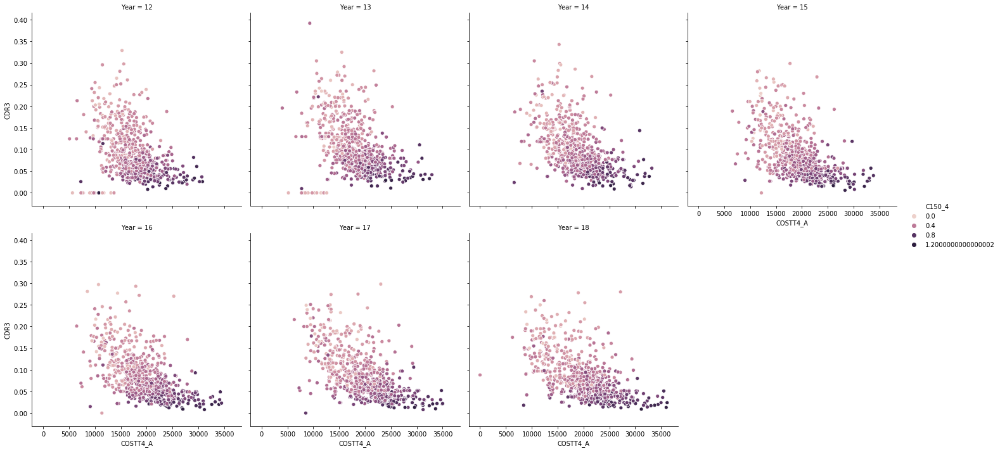

In [124]:
fig = sns.relplot(x='COSTT4_A', y='CDR3', kind='scatter', aspect=1,
               col='Year', col_wrap=4, data=df_monetary_public, hue='C150_4')

fig.savefig('Resources/cost_default_years.png')

In [ ]:
sns.relplot(x='UGDS_WHITE', y='CDR3', size='TUITIONFEE_IN', kind='scatter', aspect=1,
               col='HBCU', col_wrap=2, data=df_all)

In [ ]:
sns.scatterplot(x=df_all.loc[(df_all['HBCU'] == 1) | (df_all['PBI'] == 1) |
                (df_all['ANNHI'] == 1) | (df_all['AANAPII'] == 1) | df_all['TRIBAL'] == 0]
                ['UGDS_WHITE'], 
                y=df_all['CDR3'])